In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
import matplotlib.pylab as plt
import matplotlib as mpl
import matplotlib.font_manager as fm
import missingno as msno
font_list = fm.findSystemFonts(fontpaths = None, fontext = 'ttf')
font_list[:]

plt.rc('font', family='NanumGothic') # For Windows
print(plt.rcParams['font.family'])

['NanumGothic']


In [25]:
df = pd.read_csv('/Users/kimjeongseob/Desktop/Github upload/5.EDA/EDA 프로젝트/googleplaystore.csv')
df.head()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",2.0.0,4.0.3 and up
2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1.2.4,4.0.3 and up
3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",Varies with device,4.2 and up
4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1.1,4.4 and up


# Google Play Store data EDA 분석

## 데이터 소개

# Google Play Store Apps

저희가 사용한 data는 Google Play Store에서 수집된 데이터로 Kaggle에 올라와 있는 데이터를 사용

https://www.kaggle.com/lava18/google-play-store-apps


이 데이터는:
- 총 13개의 특징 칼럼
- 9660개의 unique한 값
- 총 10842개의 데이터
- csv 파일 
- 1개를 제외한 12개의 특징 칼럼들은 모두 object 타입

# 데이터 전처리 

1. 결측치 확인
    Rating, Version data 결측치 존재
    - Rating : 1,473개 데이터 -> NaN값 데이터 존재
        => 모두 0으로 처리 (사용자의 평가 유보 대상 서비스 판단, Install정보 기반) 
        * Installs수( Rating 0 mean / 전체 mean / 전체 median) : (4,095, 1,546만, 10만)

    - Version : Current Ver 8개 / Android Ver 2개 
        => 모두 0으로 처리 


2. 이상치 제거
    2개 행(데이터) 이상치 제거
    - 총 rows 수 : 10841개 -> 10839개


3. 컬럼별 데이터타입 변경
    Size, Reviews, Installs, Price, Rating : 숫자로 변경


4. 컬럼 추가
    - Log 값 적용한 컬럼 생성 : Installs_log, Reviews_log
    - 추가 이유 : 데이터의 증감 추세 유지 하 데이터 수치 너비를 좁혀 분석 용이성 제고


In [3]:
df = pd.read_csv('/Users/kimjeongseob/Desktop/Github upload/5.EDA/EDA 프로젝트/googleplaystore.csv')
df.head()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",2.0.0,4.0.3 and up
2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1.2.4,4.0.3 and up
3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",Varies with device,4.2 and up
4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1.1,4.4 and up


# 데이터 전처리 과정

# 1. 결측치 확인

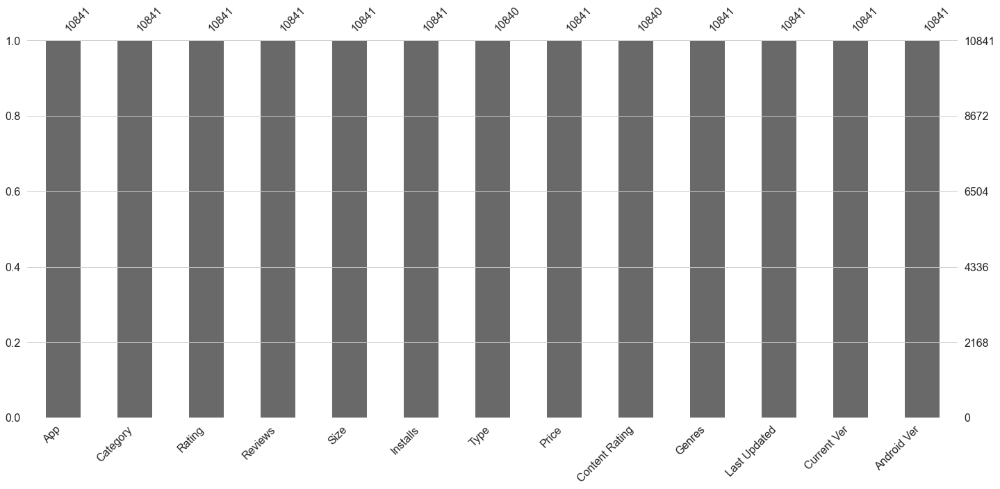

In [12]:
import missingno as msno
msno.bar(df)

# 2. 이상치 제거

In [13]:
# 이상치 제거

In [40]:
df = df.drop(index = [10472,9148])

In [41]:
# 결측치 재확인

findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.


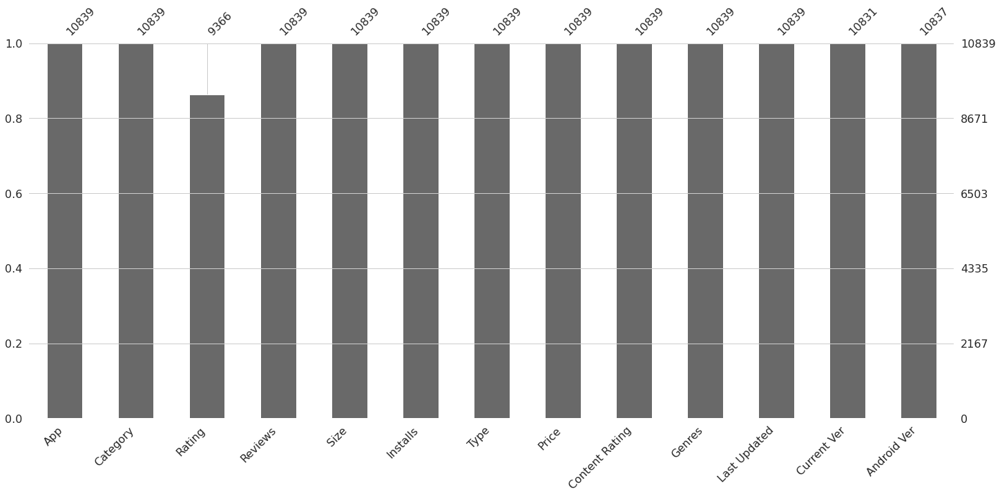

In [42]:
msno.bar(df)

In [43]:
# 결측치 확인 : 1) Rating
df['Rating'][df.Rating.isnull()] = 0

In [44]:
# 결측치 확인 : 2) Android Ver
df['Android Ver'][df['Android Ver'].isnull()] = 0

In [45]:
# 결측치 확인 : 3) Current Ver
df['Current Ver'][df['Current Ver'].isnull()] = 0

# 3. 결측치, 이상치 처리 결과

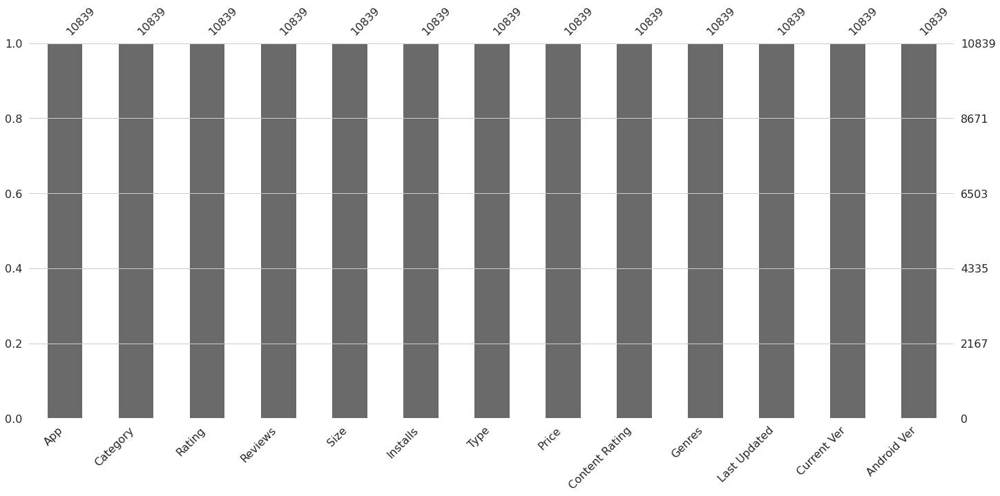

In [46]:
msno.bar(df)

# 4. Log 컬럼 생성

### 1. Install 컬럼 log 전처리

In [52]:
# '+', ',' 문자 제거

df['Installs'] = df['Installs'].apply(lambda x: x.replace('+',''))
df['Installs'] = df['Installs'].apply(lambda x: x.replace(',',''))

# object -> int 형 변환
df['Installs'] = pd.to_numeric(df['Installs'])
#결과
df['Installs']

#
df['Installs_log'] = np.log10(df.Installs)

#
df['Installs_log'].loc[df.Installs_log == float('-inf')] = 0

#
df.Installs_log.unique()

array([4.     , 5.69897, 6.69897, 7.69897, 5.     , 4.69897, 6.     ,
       7.     , 3.69897, 8.     , 9.     , 3.     , 8.69897, 1.69897,
       2.     , 2.69897, 1.     , 0.     , 0.69897])

### 2. Reviews 컬럼 log 전처리

In [53]:
# 형 변환 (object -> numeric)
df['Reviews'] = pd.to_numeric(df['Reviews'])

In [54]:
df['Reviews_log'] = np.log10(df['Reviews'])

In [55]:
df['Reviews_log'].loc[df.Reviews_log == float('-inf')] = 0

# 5. 컬럼별 type 변경
    - 각 컬럼별 분석에서 실시

# 컬럼 별 데이터 분석


### 1. Category


In [4]:
df[df['Category'] == '1.9']

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,Installs_log


In [5]:
# 데이터 제거 - 10472 행

df = df.drop(df.index[[10472]])

### Countplot of Number of Apps on the basis of category


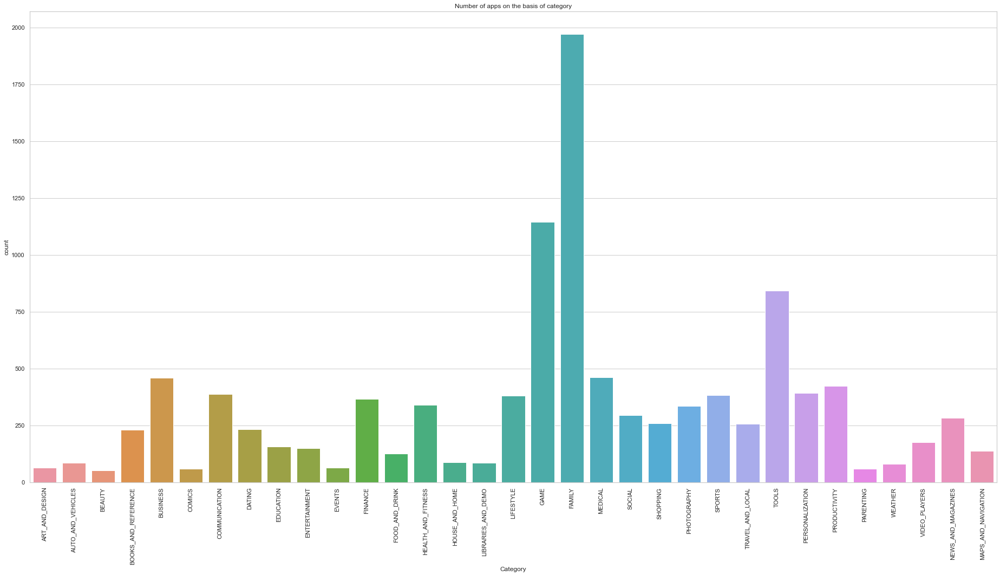

In [6]:
sns.set_style('whitegrid')
plt.figure(figsize=(32,16))
plt.title('Number of apps on the basis of category')
sns.countplot(x='Category',data = df)
plt.xticks(rotation=90)
plt.show()

### Top 10 App Categories

In [7]:
category = pd.DataFrame(df['Category'].value_counts())        #Dataframe of apps on the basis of category
category.rename(columns = {'Category':'Count'},inplace=True)

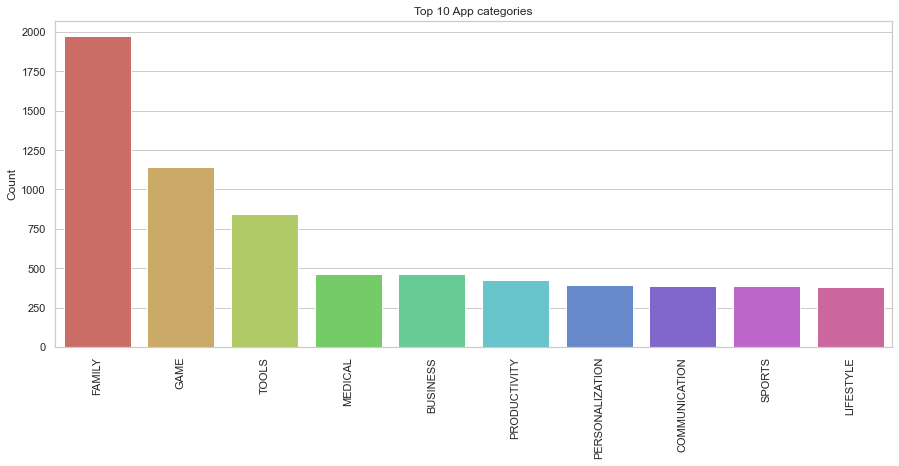

In [8]:
plt.figure(figsize=(15,6))
sns.barplot(x=category.index[:10], y ='Count',data = category[:10],palette='hls')
plt.title('Top 10 App categories')
plt.xticks(rotation=90)
plt.show()

### Finding

    1) 가장 많은 카테고리 : Family(18%), Game(11%)
    2) 가장 적은 카테고리 : Beauty(1%), Cosmic(1%)


### 2. Rating


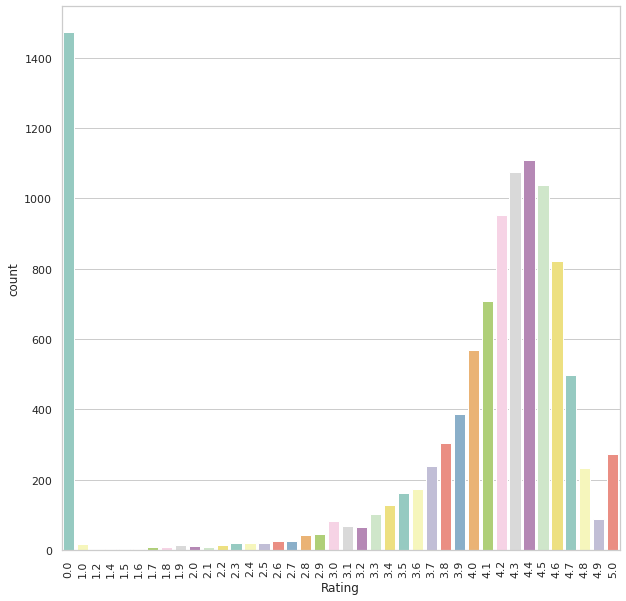

In [93]:
#각 Rating별 갯수
plt.subplots(figsize=(10,10))
plt.xticks(rotation=90)
ax = sns.countplot(x="Rating", data=df, palette="Set3")

In [28]:
rating_greater_4 = len(df[df['Rating'] >= 4])/len(df)*100
print('Percentage of Apps having ratings of 4 or greater: {}%'.format(round(rating_greater_4,2)))


Percentage of Apps having ratings of 4 or greater: 67.97%


### Finding

    1) 4점 이상의 앱 비중 : 67.97%

In [11]:
#Rating describe
df['Rating'].describe()

count    9365.000000
mean        4.191757
std         0.515246
min         1.000000
25%         4.000000
50%         4.300000
75%         4.500000
max         5.000000
Name: Rating, dtype: float64

In [12]:
# Rating 외도,첨도,중앙값 
print("Skewness: %f" % df['Rating'].skew())
print("Kurtosis: %f" % df['Rating'].kurt())
print("median: %f" % df['Rating'].median())

Skewness: -1.849591
Kurtosis: 5.785974
median: 4.300000


### Rating 평균은 4.19 중앙값은 4.3 으로 크게 다르지 않았으며  비대칭도는 -2로 크게 벗어나지 않았다 

Text(0.5, 1.0, ' Installs_log VS Rating')

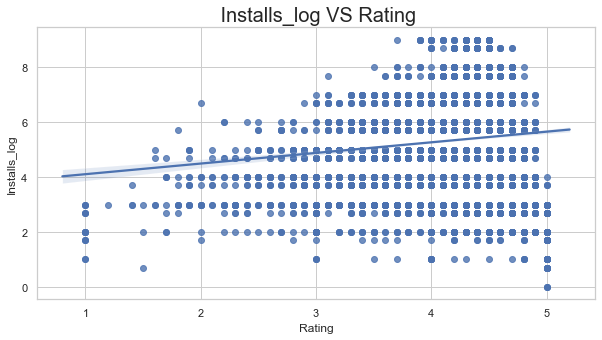

In [13]:
#Rating와Installs_log 전체 산점도
rcParams['figure.figsize'] = (10, 5)
sns.regplot(x = 'Rating', y = 'Installs_log', data = df) 
plt.title(" Installs_log VS Rating", size = 20)

In [14]:
df.describe()

,Rating,Installs,Installs_log
count,9365.000000,1.083900e+04,10839.000000
mean,4.191757,1.546484e+07,4.880817
std,0.515246,8.503327e+07,1.975355
min,1.000000,0.000000e+00,0.000000
25%,4.000000,1.000000e+03,3.000000
50%,4.300000,1.000000e+05,5.000000
75%,4.500000,5.000000e+06,6.698970
max,5.000000,1.000000e+09,9.000000


In [15]:
#상관관계
df.corr()

,Rating,Installs,Installs_log
Rating,1.000000,0.051355,0.119587
Installs,0.051355,1.000000,0.318595
Installs_log,0.119587,0.318595,1.000000


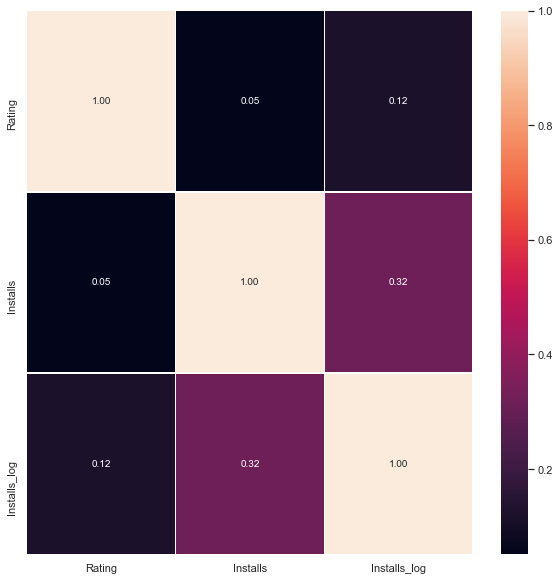

In [16]:
f,ax = plt.subplots(figsize = (10,10))
sns.heatmap(df.corr(), annot = True, linewidths = .5, fmt = ".2f", ax=ax)

### Installs_log 와 Rating의 전체 산점도는 3 ~ 5사이에 가장 많이 분포 되어 있으며 상관관계는 낮았다. 
### Rating이 높다고 해서 좋은 앱은 아니며 Install 에 영향을 주진 않았다 

In [17]:
rating_greater_4 = len(df[df['Rating'] >= 4])/len(df)*100
print('Percentage of Apps having ratings of 4 or greater: {}%'.format(round(rating_greater_4,2)))



Percentage of Apps having ratings of 4 or greater: 67.97%


### 3.Size


```
In the Size columns either the size is given in MB or kB or it's written that the size varies with the device.
I have converted all the app sizes given in kB and MB to MB. Also 1 have used 1kB = 1000MB
```

In [18]:
df['Size'] = df['Size'].apply(lambda x: str(x).replace('M',''))
df['Size'] = df['Size'].apply(lambda x: str(x).replace('k','e-3'))

In [19]:
#Converting the data type of Size category to float wherever possible
def convert(val):
    try:
        return float(val)
    except:
        return val
df['Size'] = df['Size'].apply(lambda x: convert(x))


In [20]:
#Seperate the apps whose size is given from those whose size varies with the device.
sized = df[df['Size'] != 'Varies with device'].copy()

In [21]:
sized['Size'] = pd.to_numeric(sized['Size'])

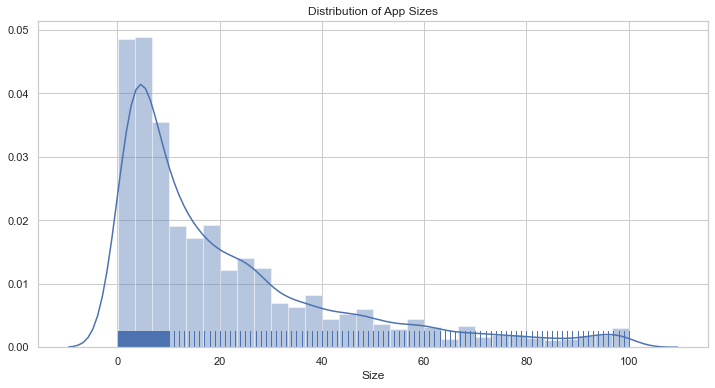

In [22]:
plt.figure(figsize=(12,6))
plt.title('Distribution of App Sizes')
sns.distplot(sized['Size'],bins = 30,rug=True)
plt.show()


```
In the dataset majority(88%) of the apps whose size are given have app size less than or equal to 50MB
```
### App Size는 0과 10MB 이내에 가장 많이 분포 되어 있다. 
### 10MB이상과 비교했을때 큰 차이를 보였다

### 4.Reviews

In [56]:
# 형 변환 (object -> numeric)
df['Reviews'] = pd.to_numeric(df['Reviews'])

In [57]:
df['Reviews_log'] = np.log10(df['Reviews'])

In [58]:
df.loc[df.Reviews_log == float('-inf')] = 0

In [59]:
df.sort_values('Reviews_log',ascending=False).head(2).Reviews

2544    78158306
3943    78128208
Name: Reviews, dtype: int64

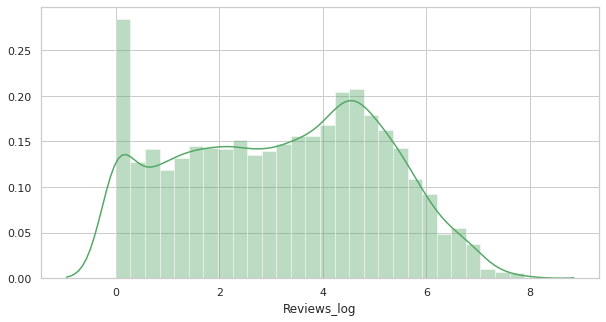

In [60]:
#histogram

plt.figure(figsize=(10,5))
sns.distplot(df['Reviews_log'],color='g')

In [61]:
print("reviews_log 최소값 : {}, 최대값 : {}".format(df.Reviews_log.min(),df.Reviews_log.max()))

reviews_log 최소값 : 0.0, 최대값 : 7.892975137931482


### Findings

    1) Review 갯수는 약 1억개까지 분포
    2) Review 갯수 상위 앱은 Facebook (약 1억 5천개)

### 4. Installs

count    10839.000000
mean         4.809655
std          2.113071
min          0.000000
25%          3.000000
50%          5.000000
75%          6.698970
max          9.000000
Name: Installs_log, dtype: float64


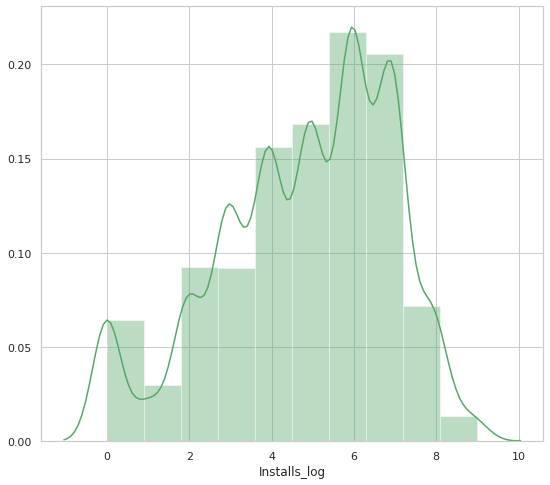

In [62]:
print(df['Installs_log'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['Installs_log'], color='g', bins=10, hist_kws={'alpha': 0.4});

In [36]:
print("평균 설치횟수 : {}회, 최대 설치횟수 : {}회, 최소 설치횟수 : {}회".format(df['Installs'].mean(),df['Installs'].max(),df['Installs'].min()))


평균 설치횟수 : 15464803.26884399회, 최대 설치횟수 : 1000000000회, 최소 설치횟수 : 0회


### Finding
```
    1) 설치횟수가 1백만 이상인 앱의 비중 : 14.57%, 1천만 이상인 앱의 비중 : 11.55%
    2) 평균 설치 횟수 : 1천 5백만 회
    3) 최대 설치 횟수 : 10억 회
    4) 최소 설치 횟수 : 0회
```

### 5. Type


In [37]:
print('Apps on the basis of Type are classified as')
print('--------------------------------------------------------------------')

count = 1
for i in df['Type'].unique():
    print(count,': ',i)
    count = count + 1

Apps on the basis of Type are classified as
--------------------------------------------------------------------
1 :  Free
2 :  Paid
3 :  0


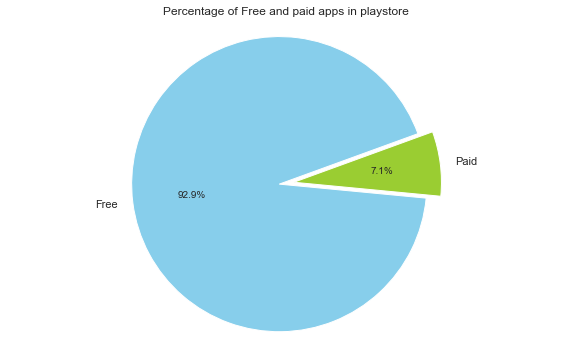

In [38]:
plt.figure(figsize=(10,6))

# Data to plot
labels = ['Free','Paid']
sizes = [len(df[df['Type'] == 'Free']),len(df[df['Type'] == 'Paid'])]
colors = ['skyblue', 'yellowgreen','orange','gold']
explode = (0.1, 0)  # explode 1st slice
 
# Plot
plt.title('Percentage of Free and paid apps in playstore')
plt.pie(sizes, labels=labels,
autopct='%1.1f%%', startangle=380,colors=colors,explode=explode)

plt.axis('equal')
plt.show()

```
Most of the apps in the app store are free.Only a small percentage of apps are paid apps.
```

### 6. Price : 무료 앱 제외 후 분석 (무료 앱 갯수 : 790개)

In [64]:
df['Price'] = df['Price'].apply(lambda x: str(x).replace('$',''))
df['Price'] = pd.to_numeric(df['Price'])


```
I have created a seperate dataset for paid apps from the whole playstore dataset
```

In [65]:
paid_apps = df[df['Price'] != 0]

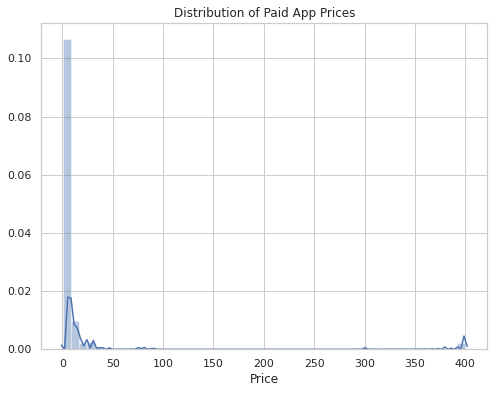

In [66]:
plt.figure(figsize=(8,6))
plt.title('Distribution of Paid App Prices')
sns.distplot(paid_apps['Price'],bins=50)
plt.show()

In [67]:
price_less_10 = len(paid_apps[paid_apps['Price'] <= 10])/len(paid_apps)*100
print('Percentage of Apps having price less than 10$: {}%'.format(round(price_less_10,2)))

Percentage of Apps having price less than 10$: 89.36%


In [68]:
paid_apps[paid_apps['Price'] >= 350]

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,Reviews_log,Installs_log
4197,most expensive app (H),FAMILY,4.3,6,1.5M,100,Paid,399.99,Everyone,Entertainment,"July 16, 2018",1.0,7.0 and up,0.778151,2.00000
4362,💎 I'm rich,LIFESTYLE,3.8,718,26M,10000,Paid,399.99,Everyone,Lifestyle,"March 11, 2018",1.0.0,4.4 and up,2.856124,4.00000
4367,I'm Rich - Trump Edition,LIFESTYLE,3.6,275,7.3M,10000,Paid,400.00,Everyone,Lifestyle,"May 3, 2018",1.0.1,4.1 and up,2.439333,4.00000
5351,I am rich,LIFESTYLE,3.8,3547,1.8M,100000,Paid,399.99,Everyone,Lifestyle,"January 12, 2018",2.0,4.0.3 and up,3.549861,5.00000
5354,I am Rich Plus,FAMILY,4.0,856,8.7M,10000,Paid,399.99,Everyone,Entertainment,"May 19, 2018",3.0,4.4 and up,2.932474,4.00000
5356,I Am Rich Premium,FINANCE,4.1,1867,4.7M,50000,Paid,399.99,Everyone,Finance,"November 12, 2017",1.6,4.0 and up,3.271144,4.69897
5357,I am extremely Rich,LIFESTYLE,2.9,41,2.9M,1000,Paid,379.99,Everyone,Lifestyle,"July 1, 2018",1.0,4.0 and up,1.612784,3.00000
5358,I am Rich!,FINANCE,3.8,93,22M,1000,Paid,399.99,Everyone,Finance,"December 11, 2017",1.0,4.1 and up,1.968483,3.00000
5359,I am rich(premium),FINANCE,3.5,472,965k,5000,Paid,399.99,Everyone,Finance,"May 1, 2017",3.4,4.4 and up,2.673942,3.69897
5362,I Am Rich Pro,FAMILY,4.4,201,2.7M,5000,Paid,399.99,Everyone,Entertainment,"May 30, 2017",1.54,1.6 and up,2.303196,3.69897


### Finding
```
    1) 10$ 이하 앱 비중 : 89%
    2) 350$ 이상 앱 : 16개의 앱이 350$ 이상의 Price. 8건 이상이 10,000건 이상의 다운로드 횟수 기록
```

### 7. Content Rating


In [44]:
print('Apps on the basis of Content Rating are classified as')
print('-------------------------------------------------------------------')

count = 1
for i in df['Content Rating'].unique():
    print(count,': ',i)
    count = count + 1

Apps on the basis of Content Rating are classified as
-------------------------------------------------------------------
1 :  Everyone
2 :  Teen
3 :  Everyone 10+
4 :  Mature 17+
5 :  Adults only 18+
6 :  0
7 :  Unrated


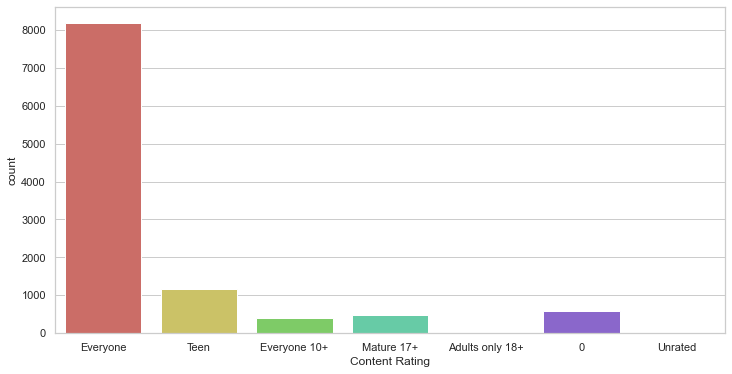

In [45]:
plt.figure(figsize=(12,6))
sns.countplot(x=df['Content Rating'],palette='hls')
plt.show()

In [46]:
print('Percentage of Apps having content rating as everyone: {}%'.format(round(len(df[df['Content Rating'] == 'Everyone'])/len(df)*100,2)))


Percentage of Apps having content rating as everyone: 75.57%


### 8. Genres


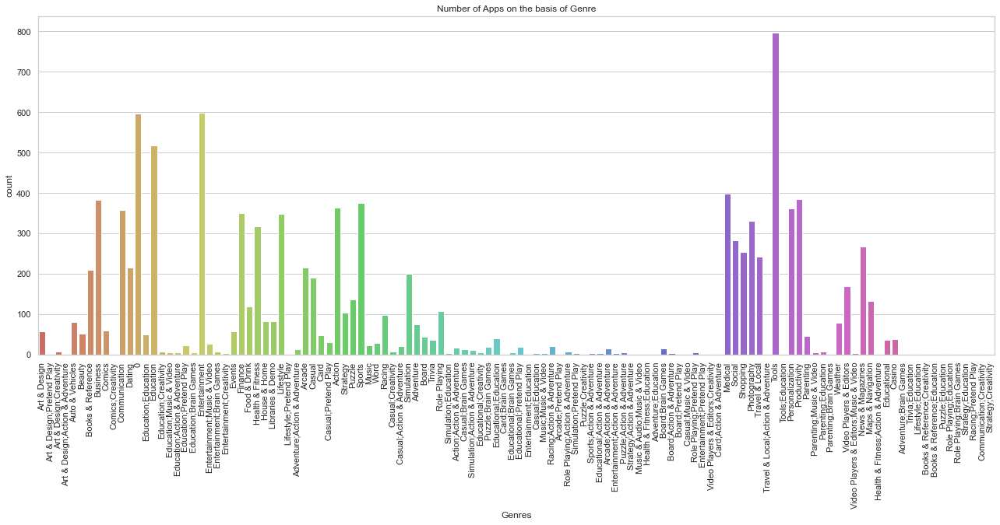

In [47]:
plt.figure(figsize=(22,8))
plt.title('Number of Apps on the basis of Genre')
sns.countplot(x='Genres',data = df,palette='hls')
plt.xticks(rotation = 90)
plt.show()

In [48]:
print('Total Number of Genres: ',df['Genres'].nunique())


Total Number of Genres:  120


```
There are 119 Genres in the app store with the Tools Genre having the highest number of apps followed by Entertainment.
```

### 10. Current Version

```
22.6% of the apps out of 10840 apps require android version 4.1 or greater version to work.
```

In [50]:
#function to convert columns to numeric data type from object data type
for i in df.columns:
    try:
        df[i] = pd.to_numeric(df[i])
    except:
        pass


# 컬럼 별 상관관계 분석

    1) Reviews_log - Installs_log
    2) Reviews_log - Rating

In [83]:
df.corr()['Reviews_log']

Rating          0.595889
Reviews         0.289233
Installs        0.314721
Price          -0.028740
Reviews_log     1.000000
Installs_log    0.956194
Name: Reviews_log, dtype: float64

### 1. Rating vs. Category

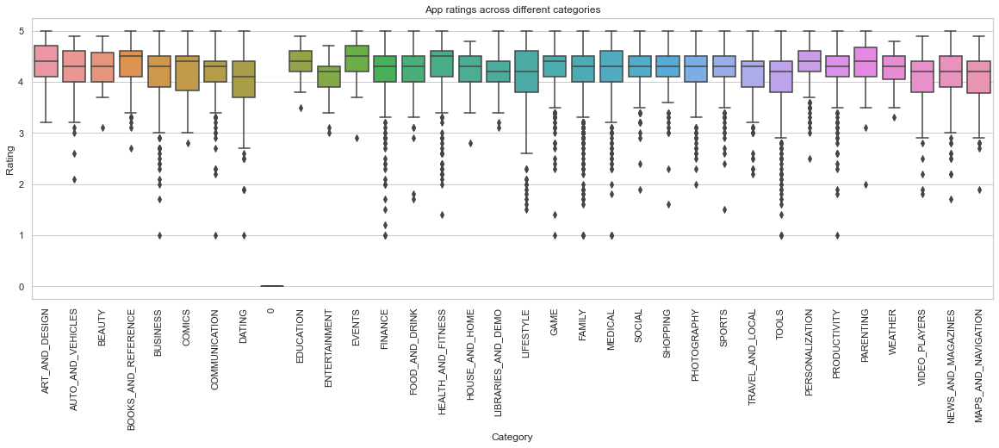

In [51]:
plt.figure(figsize=(20,6))
sns.boxplot(x='Category',y='Rating',data = df)
plt.xticks(rotation=90)
plt.title('App ratings across different categories')
plt.show()


In [52]:
rating = pd.DataFrame(df['Rating'].describe()).T
rating

,count,mean,std,min,25%,50%,75%,max
Rating,9961.0,3.94095,1.112704,0.0,3.9,4.3,4.5,5.0


### Findings

```
The minimum and maximum rating an app can have are 1 and 5 respectively across all categories.
The mean rating of apps across all categories is 4.2 with a standard deviation of 0.51. Also, the median rating of apps across all categories is 4.3.
```

### Category vs. Reviews

In [53]:
#Number of apps having 0 reviews
len(df[df['Reviews'] == 0])
review_0_category = pd.DataFrame(df[df['Reviews'] == 0]['Category'].describe())
#App having maximum reviews.
max_review_app = df[df['Reviews'] == max(df['Reviews'])]

review_0_category
max_review_app

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,Installs_log,Reviews_log
2544,Facebook,SOCIAL,4.1,78158306,Varies with device,1000000000,Free,0.0,Teen,Social,"August 3, 2018",Varies with device,Varies with device,9.0,7.892975


### Findings



1. Most of the apps across different categories have less than 10,000,000 reviews.
2. 596 apps have 0 reviews with most of the apps belonging to BUSINESS category.
3. The app having the maximum number of reviews(78158306) is Facebook which belong to the SOCIAL category.

The EDA is currently not complete and I will add more findings in the future.
Suggestions are welcome

## 1. Reviews_log와 Installs_log 분석

    1) log값 취한 데이터를 기준으로 상관성 분석
    2) 목표하는 Installs 컬럼을 포함한 전체 특징들과 분석



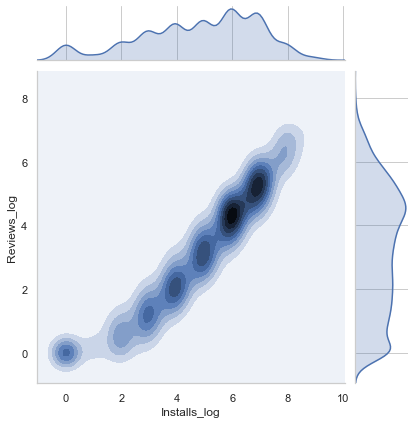

In [59]:
# kernel density function 적용

sns.jointplot(x="Installs_log", y="Reviews_log", data=df, kind='kde')

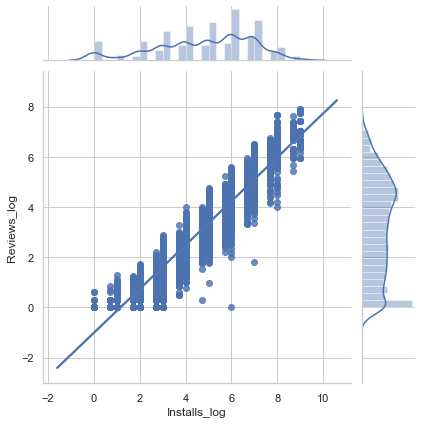

In [60]:
# joint scatter plot

sns.jointplot(x="Installs_log", y="Reviews_log", data=df, kind='reg')

In [61]:
df.corr()['Reviews_log']

Rating          0.499426
Reviews         0.289243
Installs        0.314730
Price          -0.028723
Installs_log    0.956188
Reviews_log     1.000000
Name: Reviews_log, dtype: float64

### Finding

```
Reviews수의 로그를 취한 데이터와 상관관계를 보인 데이터
    : Installs_log, Rating

```

## 2. Rating, Reviews_log 선형 분석

    1) log값 취한 데이터를 기준으로 상관성 분석
    2) Reviews와의 상관관계를 보이는 feature에 대한 추가 탐색

In [80]:
import scipy.stats as stats

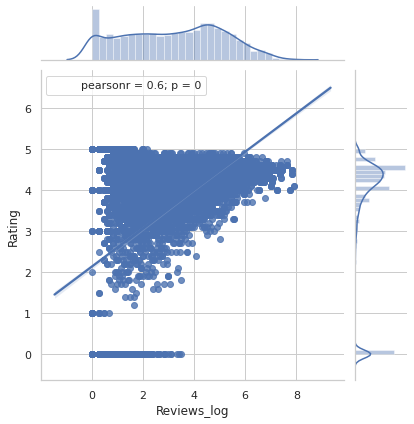

In [81]:
j = sns.jointplot(x="Reviews_log", y="Rating", data=df, kind='reg')
j.annotate(stats.pearsonr)
plt.show()

# Reviews 데이터 분석

    1) Reviews가 높은 Install과 Rating의 유의미한 상관관계를 보이는 feature임을 확인
    2) 이에 따라, 별도의 Review의 User_data 활용 분석
    3) 상위 Install 앱의 Reivew 데이터 분석 실시

In [1]:
df = pd.read_csv('3_new.csv')
df.tail()

,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0,3.69897
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0,2.00000
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0,3.00000
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0,3.00000
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0,7.00000


In [2]:
df['Reviews_log'] = np.log10(df['reviews'])
df.loc[df.Reviews_log == float('-inf')] = 0

C:\Users\Gk\anaconda3\lib\site-packages\pandas\core\series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [3]:
col = ['Category', 'Rating', 'reviews', 'Installs', 'Reviews_log', 'Installs_log']
df1 = df[col]

### Installs_log, Reviews_log의 sorting 결과, 상위 10개 데이터 분석

In [4]:
df1 = df1.sort_values(by=['Installs_log', 'Reviews_log'], ascending=False)
df1.head(10)

,Category,Rating,reviews,Installs,Reviews_log,Installs_log
2544,SOCIAL,4.1,78158306.0,1.000000e+09,7.892975,9.0
3943,SOCIAL,4.1,78128208.0,1.000000e+09,7.892808,9.0
336,COMMUNICATION,4.4,69119316.0,1.000000e+09,7.839599,9.0
381,COMMUNICATION,4.4,69119316.0,1.000000e+09,7.839599,9.0
3904,COMMUNICATION,4.4,69109672.0,1.000000e+09,7.839539,9.0
2604,SOCIAL,4.5,66577446.0,1.000000e+09,7.823327,9.0
2545,SOCIAL,4.5,66577313.0,1.000000e+09,7.823326,9.0
2611,SOCIAL,4.5,66577313.0,1.000000e+09,7.823326,9.0
3909,SOCIAL,4.5,66509917.0,1.000000e+09,7.822886,9.0
382,COMMUNICATION,4.0,56646578.0,1.000000e+09,7.753174,9.0


In [5]:
df_or = pd.read_csv('googleplaystore.csv')
df_or.tail()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
10836,Sya9a Maroc - FR,FAMILY,4.5,38,53M,"5,000+",Free,0,Everyone,Education,"July 25, 2017",1.48,4.1 and up
10837,Fr. Mike Schmitz Audio Teachings,FAMILY,5.0,4,3.6M,100+,Free,0,Everyone,Education,"July 6, 2018",1.0,4.1 and up
10838,Parkinson Exercices FR,MEDICAL,NaN,3,9.5M,"1,000+",Free,0,Everyone,Medical,"January 20, 2017",1.0,2.2 and up
10839,The SCP Foundation DB fr nn5n,BOOKS_AND_REFERENCE,4.5,114,Varies with device,"1,000+",Free,0,Mature 17+,Books & Reference,"January 19, 2015",Varies with device,Varies with device
10840,iHoroscope - 2018 Daily Horoscope & Astrology,LIFESTYLE,4.5,398307,19M,"10,000,000+",Free,0,Everyone,Lifestyle,"July 25, 2018",Varies with device,Varies with device


### Installs, Reviews 상위 10개 App

In [6]:
df_or.iloc[[2544, 3943, 336, 381, 3904, 2604, 2545, 2611, 3909, 382]].App

2544                                    Facebook
3943                                    Facebook
336                           WhatsApp Messenger
381                           WhatsApp Messenger
3904                          WhatsApp Messenger
2604                                   Instagram
2545                                   Instagram
2611                                   Instagram
3909                                   Instagram
382     Messenger – Text and Video Chat for Free
Name: App, dtype: object

In [7]:
df_r = pd.read_csv('googleplaystore_user_reviews.csv')
df_r.tail()

,App,Translated_Review,Sentiment,Sentiment_Polarity,Sentiment_Subjectivity
64290,Houzz Interior Design Ideas,NaN,NaN,NaN,NaN
64291,Houzz Interior Design Ideas,NaN,NaN,NaN,NaN
64292,Houzz Interior Design Ideas,NaN,NaN,NaN,NaN
64293,Houzz Interior Design Ideas,NaN,NaN,NaN,NaN
64294,Houzz Interior Design Ideas,NaN,NaN,NaN,NaN


### Install, Review 최다횟수 보유 app인 Facebook의 Review Data 분석

    - Sentiment 위주 분석 진행

In [8]:
df_facebook = df_r.loc[df_r["App"] == 'Facebook']
df_facebook_f = df_facebook.sort_values(by='Sentiment_Polarity', ascending=False)
df_facebook_f.head(10)

,App,Translated_Review,Sentiment,Sentiment_Polarity,Sentiment_Subjectivity
42887,Facebook,The best free,Positive,0.700000,0.550000
42904,Facebook,Good,Positive,0.700000,0.600000
42891,Facebook,Beautiful and sweet. *,Positive,0.600000,0.825000
42871,Facebook,Do understand hindi? If understand problem mem...,Positive,0.500000,0.625000
42848,Facebook,I updated Facebook still way find marketplace....,Positive,0.500000,0.500000
42971,Facebook,Some error keeps popping everytime I link sayi...,Positive,0.472222,0.700000
42940,Facebook,Ok I'm kinda fed Facebook right now.... I clue...,Positive,0.428571,0.553571
42961,Facebook,Would great change constantly. The videos inco...,Positive,0.383333,0.544444
42967,Facebook,"Hi Facebook, far awesome. Just hope Facebook p...",Positive,0.366667,1.000000
42844,Facebook,Like wont let post pics groups select pic gall...,Positive,0.350000,0.450000


### Facebook의 Review의 Sentiment 분포도

C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


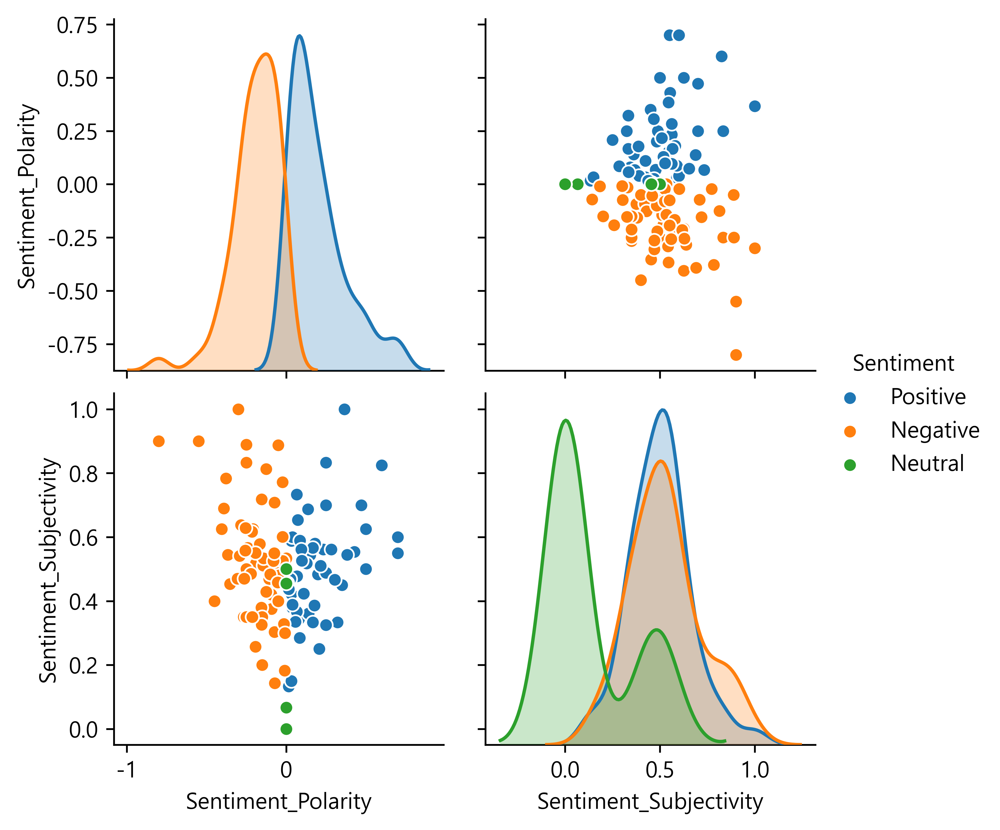

In [9]:
g = sns.pairplot(df_facebook, hue="Sentiment")

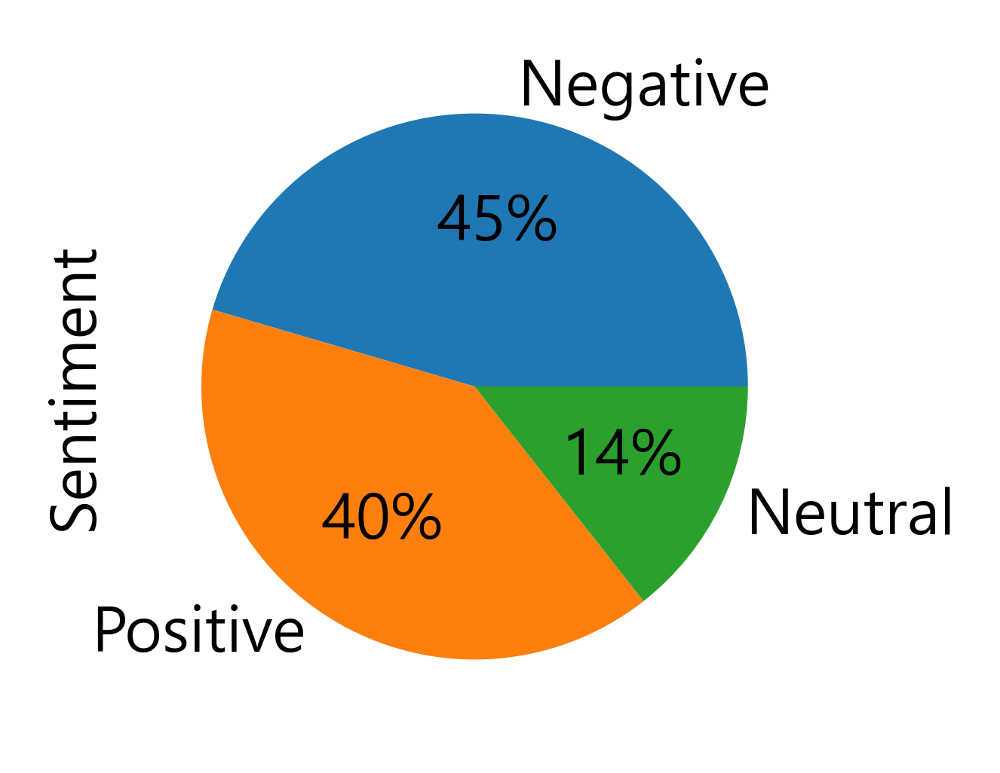

In [49]:
df_facebook["Sentiment"].value_counts().plot.pie(label='Sentiment', autopct='%1.0f%%', figsize=(2, 2))

### Whats_app, Instagram 대한 Review들은 data가 존재하지 않아 분석할 수 없음
    - 이유 : 데이터 부재(App 이름의 'I' 이후 데이터 부재)

# Conclusion

    1) 높은 Installs과 Rating을 위해선 많은 Review 갯수가 중요하다는 관계 발견
    2) Price : Price의 중요도는 상대적으로 낮은 것으로 확인됨 (상관계수 절대값 0.1 이상 feature 부재)
    3) Category : 특정 Category에 치중된 상품 구성 (예상과 달리 Social의 비중이 적음)
    4) Rating : 90% 가까이 4점 rating. 객관적인 평가가 이루어진다는 점에는 의문
    

In [91]:
df[df.Category == 'FAMILY'].sort_values('Installs',ascending=False)[:10]

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,Reviews_log,Installs_log
5856,Google Play Games,FAMILY,4.3,7168735,Varies with device,1000000000,Free,0.0,Teen,Entertainment,"July 16, 2018",Varies with device,Varies with device,6.855443,9.00000
3879,Pou,FAMILY,4.3,10483141,24M,500000000,Free,0.0,Everyone,Casual,"May 25, 2018",1.4.77,4.0 and up,7.020491,8.69897
3994,Candy Crush Saga,FAMILY,4.4,22419455,74M,500000000,Free,0.0,Everyone,Casual,"July 5, 2018",1.129.0.2,4.1 and up,7.350625,8.69897
3888,My Talking Tom,FAMILY,4.5,14885236,Varies with device,500000000,Free,0.0,Everyone,Casual,"July 19, 2018",4.8.0.132,4.1 and up,7.172756,8.69897
8439,Duolingo: Learn Languages Free,FAMILY,4.7,6297590,Varies with device,100000000,Free,0.0,Everyone,Education;Education,"August 6, 2018",Varies with device,Varies with device,6.799174,8.00000
6269,Bitmoji – Your Personal Emoji,FAMILY,4.6,2312084,Varies with device,100000000,Free,0.0,Teen,Entertainment,"July 25, 2018",Varies with device,4.3 and up,6.364004,8.00000
4036,Minion Rush: Despicable Me Official Game,FAMILY,4.5,10214862,Varies with device,100000000,Free,0.0,Everyone 10+,Casual;Action & Adventure,"July 12, 2018",Varies with device,Varies with device,7.009233,8.00000
3930,Flow Free,FAMILY,4.3,1295293,11M,100000000,Free,0.0,Everyone,Puzzle,"April 11, 2018",4.0,4.1 and up,6.112368,8.00000
4864,Angry Birds 2,FAMILY,4.6,3881752,57M,100000000,Free,0.0,Everyone,Casual,"July 26, 2018",2.21.1,4.1 and up,6.589028,8.00000
4527,ROBLOX,FAMILY,4.5,4443407,67M,100000000,Free,0.0,Everyone 10+,Adventure;Action & Adventure,"July 31, 2018",2.347.225742,4.1 and up,6.647716,8.00000


In [1]:
df = pd.read_csv('2_new.csv')
df.tail()

,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0


In [2]:
df['Installs_log'] = np.log10(df.Installs)
df.tail()

C:\Users\Gk\anaconda3\lib\site-packages\pandas\core\series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0,3.69897
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0,2.00000
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0,3.00000
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0,3.00000
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0,7.00000


In [3]:
df['Installs_log'].unique()

array([4.     , 5.69897, 6.69897, 7.69897, 5.     , 4.69897, 6.     ,
       7.     , 3.69897, 8.     , 9.     , 3.     , 8.69897, 1.69897,
       2.     , 2.69897, 1.     , 0.     , 0.69897,    -inf])

In [4]:
df.loc[df.Installs_log == float('-inf')] = 0

### Install의 Log 값 기반 분석

count    10839.000000
mean         4.881463
std          1.974904
min          0.000000
25%          3.349485
50%          5.000000
75%          6.698970
max          9.000000
Name: Installs_log, dtype: float64


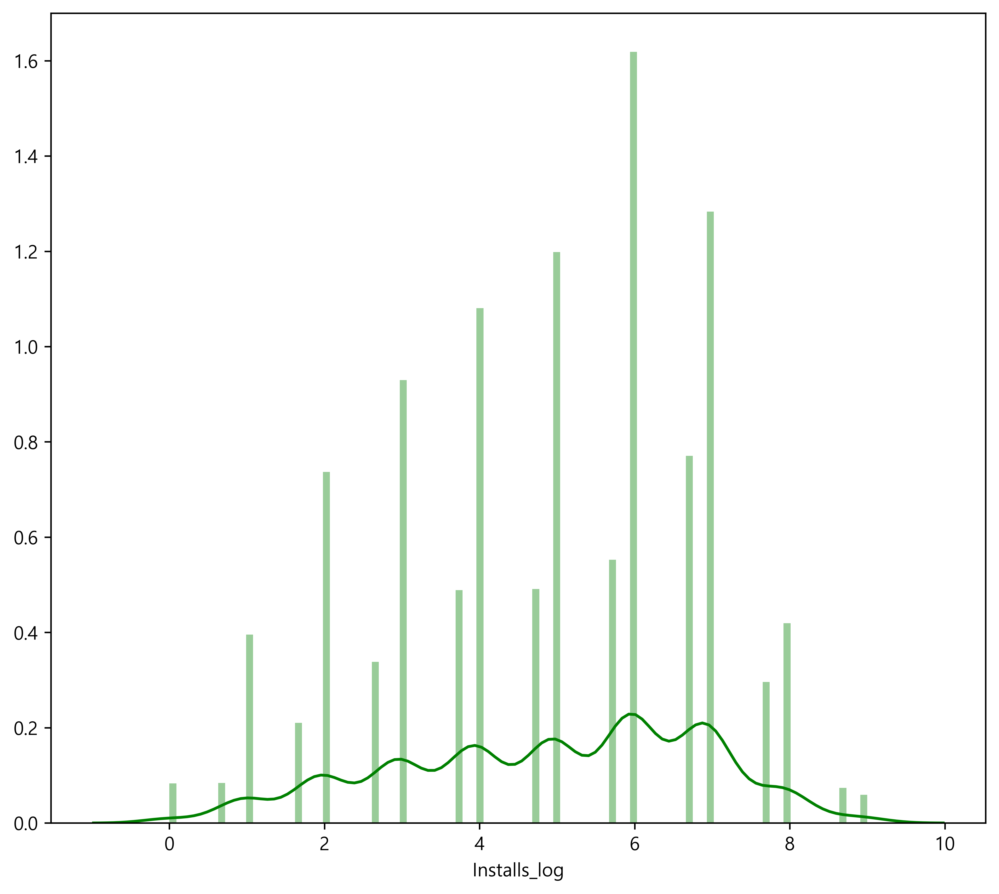

In [5]:
print(df['Installs_log'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['Installs_log'], color='g', bins=100, hist_kws={'alpha': 0.4});

In [6]:
# float64와 int64로 이루어진 데이터 타입 확인
df_num = df.select_dtypes(include = ['float64', 'int64'])
df_num.head()

,Unnamed: 0,Rating,reviews,Size,Installs,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
0,0,4.1,159.0,19.0,10000.0,0.0,0.0,1.0,2018.0,4.0,11.0,4.00000
1,1,3.9,967.0,14.0,500000.0,0.0,0.0,1.0,2018.0,4.0,11.0,5.69897
2,2,4.7,87510.0,8.7,5000000.0,0.0,0.0,8.0,2018.0,4.0,11.0,6.69897
3,3,4.5,215644.0,25.0,50000000.0,0.0,0.0,6.0,2018.0,4.0,11.0,7.69897
4,4,4.3,967.0,2.8,100000.0,0.0,0.0,6.0,2018.0,4.0,11.0,5.00000


In [7]:
col = ['Rating', 'reviews', 'Size', 'Type', 'Price', 'Ver_Mon', 'Ver_Year', 'And_1st_Ver', 'And_Last_Ver', 'Installs_log']

df_1 = df[col]
df_1.tail(1)

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10838,4.5,398307.0,19.0,0.0,0.0,7.0,2018.0,11.0,11.0,7.0


In [8]:
df_1.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [9]:
df_1_corr = df_1.corr()['Installs_log'][:-1] # 마지막 col이 Install이라 -1까지만
features_list = df_1_corr[abs(df_1_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Installs_log:
Rating          0.586801
And_1st_Ver     0.325531
reviews         0.254668
Ver_Mon         0.103135
Ver_Year        0.091992
And_Last_Ver    0.084122
Size           -0.000768
Price          -0.046416
Type           -0.237945
Name: Installs_log, dtype: float64


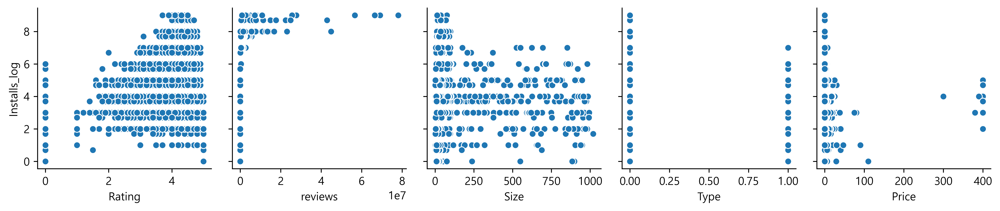

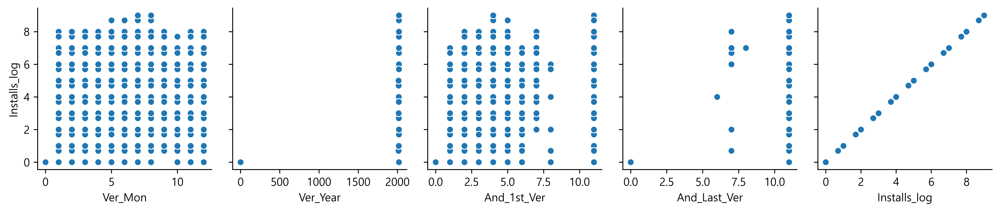

In [10]:
for i in range(0, len(df_1.columns), 5):
    sns.pairplot(data=df_1,
                 x_vars=df_1.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [11]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_1[col], ax=ax)

In [12]:
sns.set(style="ticks", color_codes="True")
g = sns.pairplot(df_1, hue="Type")

C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


### Price 기반 분석

In [41]:
col = ['Rating', 'reviews', 'Size', 'Type', 'Ver_Mon', 'Ver_Year', 'And_1st_Ver', 'And_Last_Ver', 'Installs_log', 'Price']

df_2 = df[col]
df_2.tail(1)

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
10838,4.5,398307.0,19.0,0.0,7.0,2018.0,11.0,11.0,7.0,0.0


In [42]:
df_2.describe()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
count,10839.000000,1.083900e+04,10839.000000,10839.000000,10839.000000,10839.000000,10839.000000,10819.000000,10839.000000,10839.000000
mean,3.622105,4.441939e+05,37.013073,0.072885,6.414153,2014.794169,4.643510,10.982531,4.881463,0.916252
std,1.514233,2.927893e+06,90.822287,0.259960,2.586426,72.468766,2.555032,0.411260,1.974904,14.814128
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.700000,3.800000e+01,6.800000,0.000000,5.000000,2017.000000,4.000000,11.000000,3.349485,0.000000
50%,4.200000,2.094000e+03,20.000000,0.000000,7.000000,2018.000000,4.000000,11.000000,5.000000,0.000000
75%,4.500000,5.478300e+04,37.000000,0.000000,8.000000,2018.000000,4.000000,11.000000,6.698970,0.000000
max,5.000000,7.815831e+07,1020.000000,1.000000,12.000000,2018.000000,11.000000,11.000000,9.000000,400.000000


In [43]:
df_2.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

# Price - 전체 feature 대상 Corr

In [44]:
df_2_corr = df_2.corr()['Price'][:-1]
features_list = df_2_corr[abs(df_2_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Price:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Price:
Type            0.220601
Size            0.017400
And_Last_Ver    0.002625
Ver_Year        0.002134
Rating          0.000339
Ver_Mon         0.000189
reviews        -0.009271
And_1st_Ver    -0.015473
Installs_log   -0.046416
Name: Price, dtype: float64


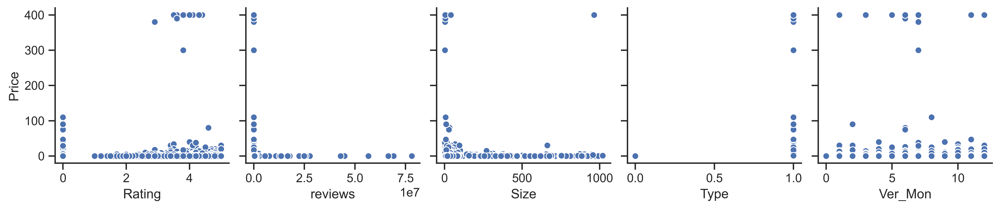

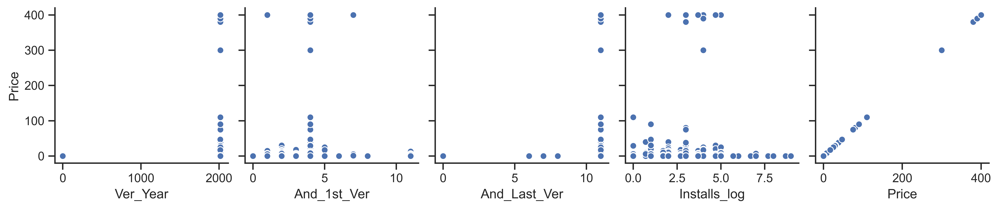

In [45]:
for i in range(0, len(df_2.columns), 5):
    sns.pairplot(data=df_2,
                 x_vars=df_2.columns[i:i+5],
                 y_vars=['Price']
                )

In [46]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Price', data=df_2[col], ax=ax)

### Outlier 제거

In [47]:
df_out = df_2.loc[df_2.Price < 250]
df_out.tail()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
10834,4.5,38.0,53.0,0.0,7.0,2017.0,4.0,11.0,3.69897,0.0
10835,5.0,4.0,3.6,0.0,7.0,2018.0,4.0,11.0,2.00000,0.0
10836,0.0,3.0,9.5,0.0,1.0,2017.0,2.0,11.0,3.00000,0.0
10837,4.5,114.0,37.0,0.0,1.0,2015.0,11.0,11.0,3.00000,0.0
10838,4.5,398307.0,19.0,0.0,7.0,2018.0,11.0,11.0,7.00000,0.0


In [48]:
df_out.describe()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
count,10824.000000,1.082400e+04,10824.000000,10824.000000,10824.000000,10824.000000,10824.000000,10804.000000,10824.000000,10824.000000
mean,3.621766,4.448086e+05,36.962962,0.071600,6.414265,2014.790188,4.644401,10.982506,4.883165,0.375222
std,1.515193,2.929874e+06,90.440044,0.257837,2.585620,72.518886,2.556365,0.411545,1.975556,2.713233
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.700000,3.800000e+01,6.800000,0.000000,5.000000,2017.000000,4.000000,11.000000,3.698970,0.000000
50%,4.200000,2.107000e+03,20.000000,0.000000,7.000000,2018.000000,4.000000,11.000000,5.000000,0.000000
75%,4.500000,5.501175e+04,37.000000,0.000000,8.000000,2018.000000,4.000000,11.000000,6.698970,0.000000
max,5.000000,7.815831e+07,1020.000000,1.000000,12.000000,2018.000000,11.000000,11.000000,9.000000,109.990000


In [49]:
df_out.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

# Price - 전체 250$ 이하 대상 Corr

In [50]:
df_out_corr = df_out.corr()['Price'][:-1]
features_list = df_out_corr[abs(df_out_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Price:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Price:
Type            0.498002
Size            0.012249
Ver_Mon         0.008285
And_Last_Ver    0.005860
Ver_Year        0.003770
reviews        -0.020419
Rating         -0.031025
And_1st_Ver    -0.034287
Installs_log   -0.129088
Name: Price, dtype: float64


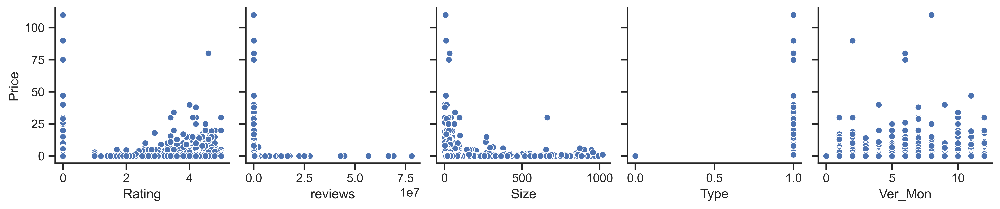

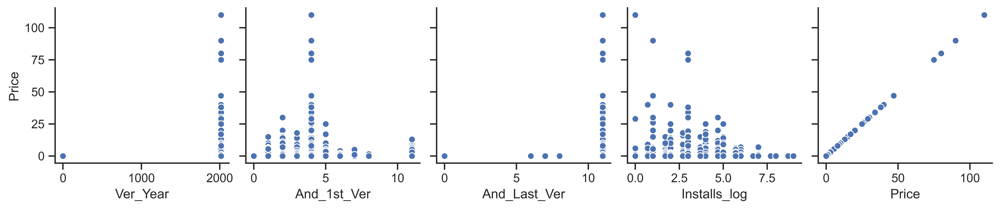

In [51]:
for i in range(0, len(df_out.columns), 5):
    sns.pairplot(data=df_out,
                 x_vars=df_out.columns[i:i+5],
                 y_vars=['Price']
                )

In [52]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Price', data=df_out[col], ax=ax)

# Price Corr 결론 중간 요약 

1. 가격 - 큰 correlation이 없음
2. install log : -0.046 -> -0.129
3. size : 0.017 -> 0.012

In [53]:
### $10 이하 유료앱

In [54]:
df_10 = df_2.loc[df_2.Price < 10]
df_10.tail()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
10834,4.5,38.0,53.0,0.0,7.0,2017.0,4.0,11.0,3.69897,0.0
10835,5.0,4.0,3.6,0.0,7.0,2018.0,4.0,11.0,2.00000,0.0
10836,0.0,3.0,9.5,0.0,1.0,2017.0,2.0,11.0,3.00000,0.0
10837,4.5,114.0,37.0,0.0,1.0,2015.0,11.0,11.0,3.00000,0.0
10838,4.5,398307.0,19.0,0.0,7.0,2018.0,11.0,11.0,7.00000,0.0


In [55]:
df_10.describe()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
count,10753.000000,1.075300e+04,10753.000000,10753.000000,10753.000000,10753.000000,10753.00000,10733.000000,10753.000000,10753.000000
mean,3.622766,4.477402e+05,36.950944,0.065470,6.410955,2014.777457,4.64940,10.982391,4.895815,0.212711
std,1.513881,2.939309e+06,90.458430,0.247365,2.580962,72.757665,2.56018,0.412901,1.973193,0.976209
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
25%,3.700000,3.800000e+01,6.900000,0.000000,5.000000,2017.000000,4.00000,11.000000,3.698970,0.000000
50%,4.200000,2.178000e+03,20.000000,0.000000,7.000000,2018.000000,4.00000,11.000000,5.000000,0.000000
75%,4.500000,5.619700e+04,37.000000,0.000000,8.000000,2018.000000,4.00000,11.000000,6.698970,0.000000
max,5.000000,7.815831e+07,1020.000000,1.000000,12.000000,2018.000000,11.00000,11.000000,9.000000,9.990000


In [56]:
df_10.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

# Price - 10$ 이하 대상 Corr

In [57]:
df_10_corr = df_10.corr()['Price'][:-1]
features_list = df_10_corr[abs(df_10_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Price under $10:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Price under $10:
Type            0.823270
Size            0.033029
And_Last_Ver    0.009253
Ver_Year        0.005846
Ver_Mon        -0.003651
Rating         -0.009730
reviews        -0.031616
And_1st_Ver    -0.047043
Installs_log   -0.168328
Name: Price, dtype: float64


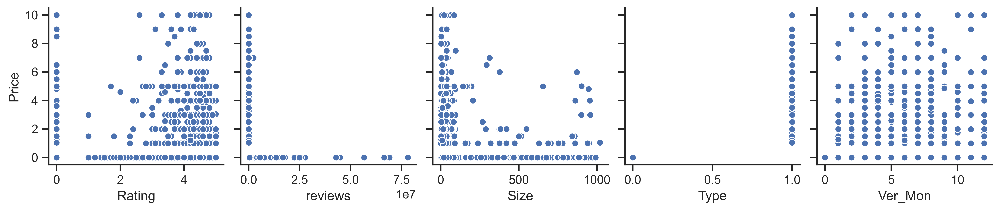

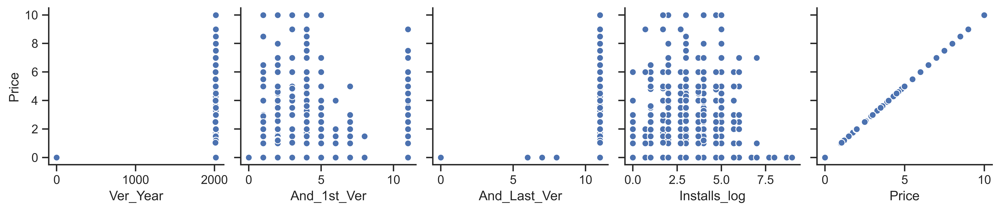

In [58]:
for i in range(0, len(df_10.columns), 5):
    sns.pairplot(data=df_10,
                 x_vars=df_10.columns[i:i+5],
                 y_vars=['Price']
                )

In [59]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Price', data=df_10[col], ax=ax)

In [60]:
df.tail()

,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0,3.69897
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0,2.00000
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0,3.00000
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0,3.00000
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0,7.00000


In [61]:
# csv로 저장
df.to_csv('3_new.csv', index=False)